# Time-dependent One-Dimensional Schrodinger Equation for Harmonic Oscillator via the Fourier split operator method

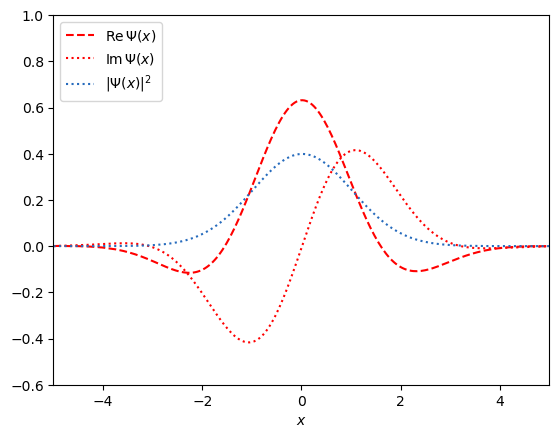

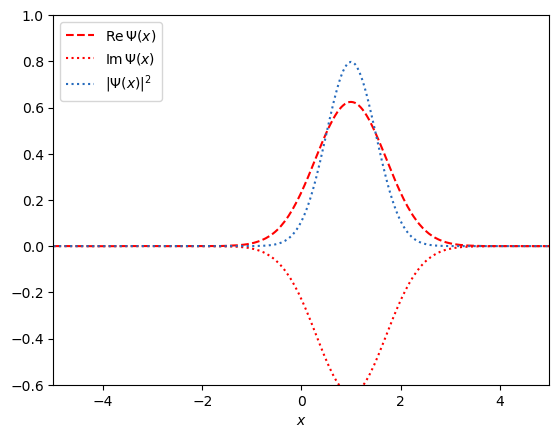

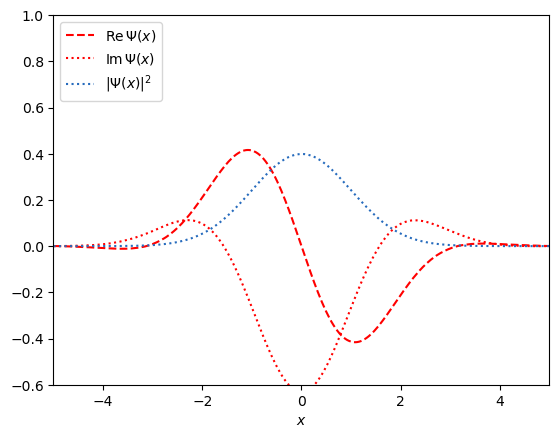

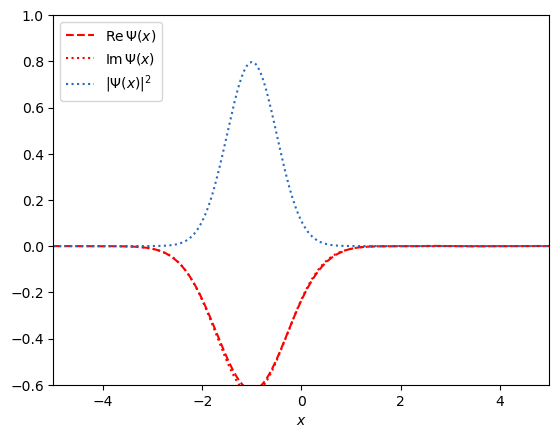

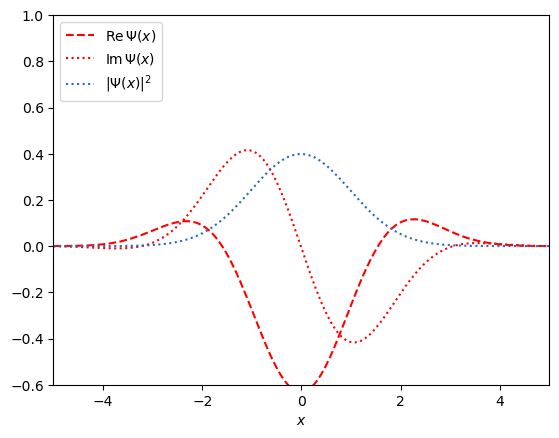

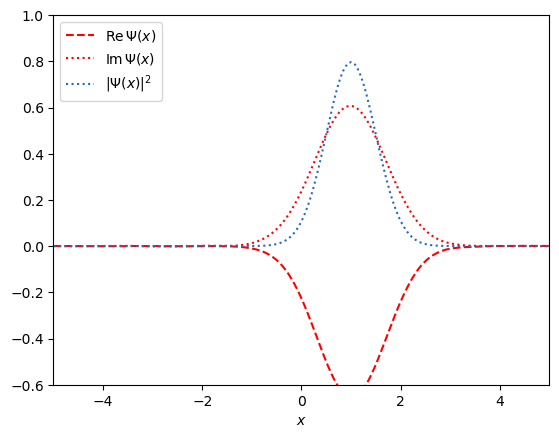

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Define the potential for the harmonic oscillator
def V(x):
    return 0.5 * x**2  # Let m = w = 1

# Define the spatial domain
N = 256                 # Number of grid points
x_domain = [-5.0, 5.0]  # Spatial domain

dx = (x_domain[1] - x_domain[0]) / (N-1)  # Define spatial step size
dt = 1.0 / 64.0  # Define temporal step size

x = np.linspace(x_domain[0], x_domain[1], N)  # Define spatial grid points

# Define the momentum domain
dp = 2*np.pi / (N*dx)   # Define momentum step size

p = np.linspace(0.0, (N-1)*dp, N)  # Define momentum grid points
p[p>0.5*N*dp] -= N*dp              # handle periodicity

# Initial Gaussian wave packet
d = np.sqrt(2.0)
k = 1.0
Psi = 1.0 / (np.pi**0.25 * np.sqrt(d)) * np.exp(-x**2.0 / (2.0 * d**2) + 1j * k * x)

# Construct the propagators/operators
U_1 = np.exp(-0.5*1j*V(x)*dt)
U_2 = np.exp(-1j*0.5*p**2*dt)

# Propagate 512 time steps
for l in range(0, 512):
    Psi *= U_1          # apply U_1 in real space
    Psi = np.fft.fft(Psi)   # go to Fourier space
    Psi *= U_2          # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi)  # go to real space
    Psi *= U_1          # apply U_1 in real space

    if l % 100 == 0:
        plt.clf()
        plt.plot(x, Psi.real, '--', color='r', label=r'$\mathrm{Re}\,\Psi(x)$')
        plt.plot(x, Psi.imag, ':', color='r', label=r'$\mathrm{Im}\,\Psi(x)$')
        plt.plot(x, Psi.real**2 + Psi.imag**2, ':', color='#266bbd', label=r'$|\Psi(x)|^2$')
        plt.gca().set_xlim(x_domain[0], x_domain[1])
        plt.gca().set_ylim(-0.6, 1)
        plt.xlabel(r'$x$')
        plt.legend(loc='upper left')
        plt.draw()
        plt.show()
        plt.pause(0.01)


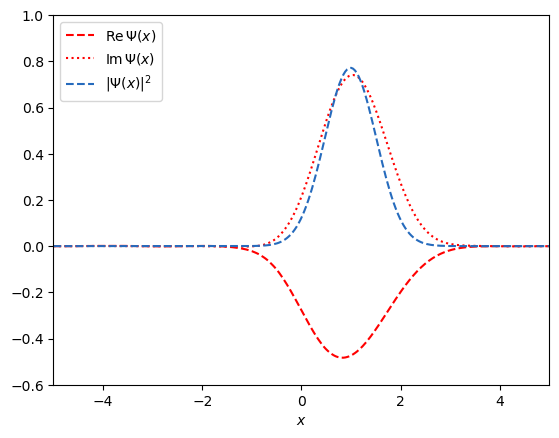

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Define the potential for the harmonic oscillator
def V(x):
    return 0.5 * x**2  # Let m = w = 1

# Define the spatial domain
N = 256                 # Number of grid points
x_domain = [-5.0, 5.0]  # Spatial domain

dx = (x_domain[1] - x_domain[0]) / (N-1)  # Define spatial step size
dt = 1.0 / 64.0  # Define temporal step size

x = np.linspace(x_domain[0], x_domain[1], N)  # Define spatial grid points

# Define the momentum domain
dp = 2*np.pi / (N*dx)   # Define momentum step size

p = np.linspace(0.0, (N-1)*dp, N)  # Define momentum grid points
p[p>0.5*N*dp] -= N*dp              # handle periodicity

# Initial Gaussian wave packet
d = np.sqrt(2.0)
k = 1.0
Psi = 1.0 / (np.pi**0.25 * np.sqrt(d)) * np.exp(-x**2.0 / (2.0 * d**2) + 1j * k * x)

# Construct the propagators/operators
U_1 = np.exp(-0.5*1j*V(x)*dt)
U_2 = np.exp(-1j*0.5*p**2*dt)

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(-0.6, 1.0)
ax.set_xlabel(r'$x$')

# Plot elements
line_real, = ax.plot([], [], "--r", label=r'$\mathrm{Re}\, \Psi(x)$')
line_imag, = ax.plot([], [], ":r", label=r'$\mathrm{Im}\, \Psi(x)$')
line_prob, = ax.plot([], [], "--", color="#266bbd", label=r'$|\Psi(x)|^2$')
ax.legend(loc='upper left')

# Initialization function
def init():
    line_real.set_data([], [])
    line_imag.set_data([], [])
    line_prob.set_data([], [])
    return line_real, line_imag, line_prob

# Update function
def update(frame):
    global Psi
    Psi *= U_1              # apply U_1 in real space
    Psi = np.fft.fft(Psi)   # go to Fourier space
    Psi *= U_2              # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi)  # go to real space
    Psi *= U_1              # apply U_1 in real space

    line_real.set_data(x, Psi.real)
    line_imag.set_data(x, Psi.imag)
    line_prob.set_data(x, Psi.real**2 + Psi.imag**2)

    return line_real, line_imag, line_prob

# Create animation
ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# Show the animation
# plt.show()
HTML(ani.to_jshtml())

# Klein Tunneling of a Dirac Wave Packet via Fourier Split operator method